In [1]:
import torch
import torchvision.datasets as datasets
from tqdm import tqdm
from torch import nn
from ipynb.fs.full.model import VariationalAutoEncoder
from torchvision import transforms
from torchvision.utils import save_image  
from torch.utils.data import DataLoader, RandomSampler
import numpy as np
import matplotlib.pyplot as plt
import os
from mpl_toolkits import mplot3d
import cv2

In [2]:
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
INPUT_DIM = 256
INIT_DIM = 8
LATENT_DIM = 3
NUM_EPOCHS = 50
BATCH_SIZE = 1
LR_RATE = 3e-4
KERNEL_SIZE = 4

In [6]:
# Dataset Loading
data_path = 'dataset2' # setting path
transform = transforms.Compose([transforms.Resize((INPUT_DIM, INPUT_DIM)),   # sequence of transformations to be done
                                transforms.Grayscale(num_output_channels=1), # on each image (resize, greyscale,
                                transforms.ToTensor()])                      # convert to tensor)

dataset = datasets.ImageFolder(root=data_path, transform=transform) # read data from folder

train_loader = DataLoader(dataset=dataset, batch_size=BATCH_SIZE, shuffle=True) # create dataloader object

model = VariationalAutoEncoder(init_dim=INIT_DIM, latent_dim=LATENT_DIM, kernel_size=KERNEL_SIZE).to(DEVICE) # initializing model object

optimizer = torch.optim.Adam(model.parameters(), lr=LR_RATE) # defining optimizer
loss_fn = nn.BCELoss(reduction='sum') # define loss function

In [8]:
model = VariationalAutoEncoder(init_dim=INIT_DIM, latent_dim=LATENT_DIM, kernel_size=KERNEL_SIZE)
model.load_state_dict(torch.load('models/test_overfitting'))
model.eval()

VariationalAutoEncoder(
  (enc1): Conv2d(1, 8, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (enc2): Conv2d(8, 16, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (enc3): Conv2d(16, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (enc4): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2))
  (fc1): Linear(in_features=14400, out_features=128, bias=True)
  (fc_mu): Linear(in_features=128, out_features=3, bias=True)
  (fc_log_var): Linear(in_features=128, out_features=3, bias=True)
  (fc2): Linear(in_features=3, out_features=256, bias=True)
  (dec1): ConvTranspose2d(256, 256, kernel_size=(4, 4), stride=(1, 1))
  (dec2): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (dec3): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (dec4): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (dec5): ConvTranspose2d(32, 8, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (dec6): ConvTranspose2d

### generating images

In [9]:
def inference(num_examples=100):
    idx = np.random.choice(range(0,400),num_examples,replace=False) # sampling from dataset
    for example,i in zip(range(num_examples),idx):
        image = dataset[i][0]
        with torch.no_grad():
            mu, sigma = model.encode(image.view(1,256,256)) # getting encoding of each image
        epsilon = torch.randn_like(sigma)
        z = mu + sigma*epsilon
        out = model.decode(z) # generating new image from the encoding
        out = out.view(-1, 1, 256, 256)
        save_image(out, f'output/256x/img_{i}.png')

In [ ]:
inference()

### getting latent variables

In [11]:
latent_spaces = []
for i in tqdm(range(len(dataset))):
    image = dataset[i][0]
    with torch.no_grad():
        mu, sigma = model.encode(image.view(1,256,256)) # getting encoding of each image
    
    latent_spaces.append([mu, sigma])

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:04<00:00, 96.46it/s]


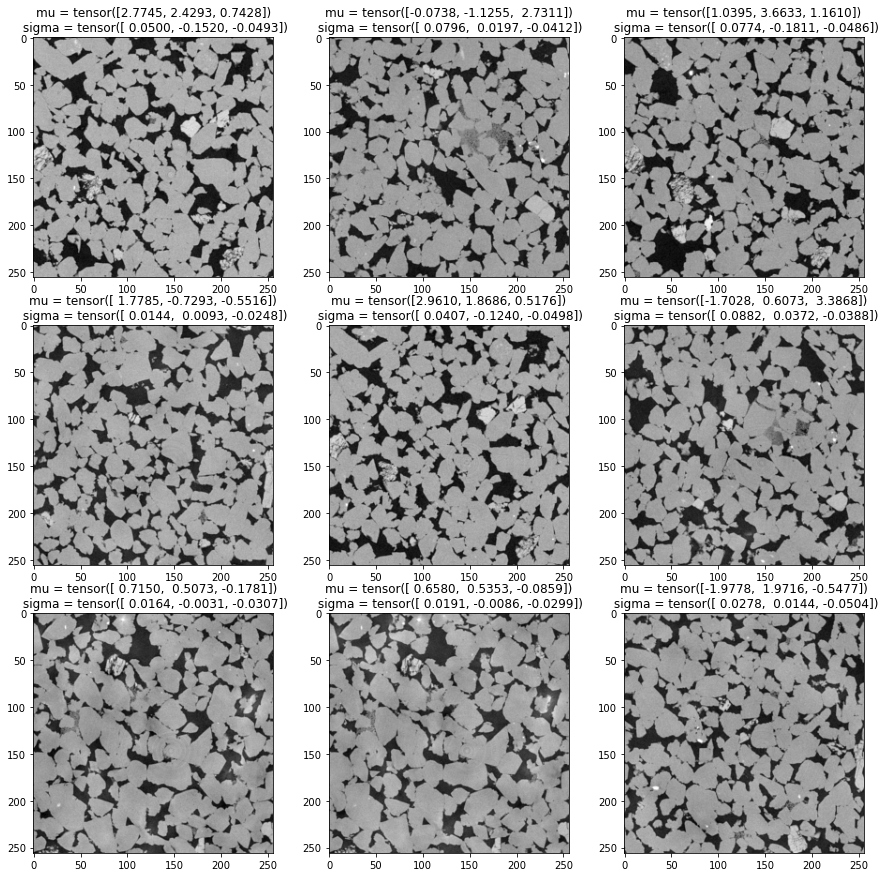

In [15]:
idx = np.random.choice(range(0,400),9,replace=False)
fig, axs = plt.subplots(3, 3, figsize=(15,15))
axs = axs.ravel()
for i,j in enumerate(idx):
    mu, sigma = latent_spaces[j]
    axs[i].imshow(dataset[j][0].numpy()[0],'gray')
    axs[i].set_title(f'mu = {mu}\n sigma = {sigma}')

In [16]:
mus = np.array([latent[0].numpy() for latent in latent_spaces])
sigmas = np.array([latent[1].numpy() for latent in latent_spaces])

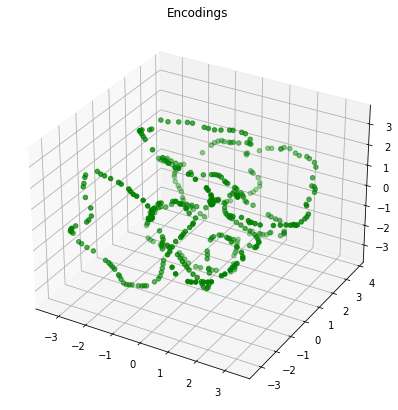

In [17]:
# Creating figure
fig = plt.figure(figsize = (10, 7))
ax = plt.axes(projection ="3d")
 
# Creating plot
ax.scatter3D(mus[:,0], mus[:,1], mus[:,2], color = "green")
plt.title("Encodings")
 
# show plot
plt.show()

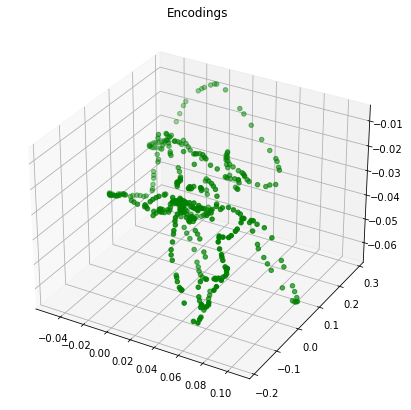

In [18]:
# Creating figure
fig = plt.figure(figsize = (10, 7))
ax = plt.axes(projection ="3d")
 
# Creating plot
ax.scatter3D(sigmas[:,0], sigmas[:,1], sigmas[:,2], color = "green")
plt.title("Encodings")
 
# show plot
plt.show()

### helper functions

In [7]:
def decode_sample(x, y, z, path):
    out = model.decode(torch.tensor([x, y, z]).float())
    out = out.view(-1, 1, 256, 256)
    save_image(out, path)

In [18]:
def reconstruct(z): # img is a tensor
    out = model.decode(z)
    out = out.view(-1, 1, 256, 256)
    save_image(out, 'temp.png')
    out = cv2.imread('temp.png')
    os.remove('temp.png')
    return out

### Some samples from one encoding

In [125]:
mu, sigma = latent_spaces[0]
epsilon = torch.randn_like(sigma)
sample = mu + sigma*epsilon
img = reconstruct(sample)

[tensor([-0.3359,  1.2140, -3.7910]), tensor([ 0.1254, -0.0373, -0.0483])]


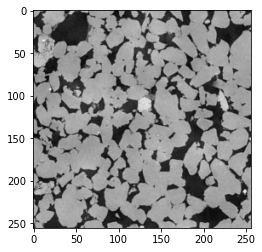

In [139]:
plt.imshow(dataset[200][0].numpy()[0],'gray')
print(latent_spaces[200])

[tensor([ 1.8138, -0.0354, -0.1343]), tensor([0.0241, 0.0366, 0.0111])]


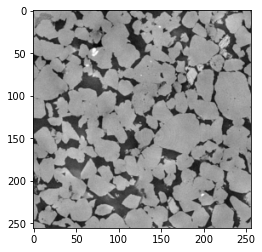

In [160]:
plt.imshow(dataset[0][0].numpy()[0],'gray')
print(latent_spaces[0])

In [167]:
# walk from img 0 to img 200

z1 = latent_spaces[0][0]
z2 = latent_spaces[200][0]

img1 = reconstruct(z1)
img2 = reconstruct(z2)

alpha = np.arange(0,1.05,.05)
zs = [(1-a)*z1 + a*z2 for a in alpha]

for i,z in enumerate(zs):
    img = reconstruct(z)
    img = img/255


    thresh = 0.5
    im_bw = cv2.threshold(img, thresh, 1, cv2.THRESH_BINARY)[1]
    plt.imsave(f'output/interpolation/{i}.png', im_bw)

tensor([ 1.7934, -0.0764, -0.1328])


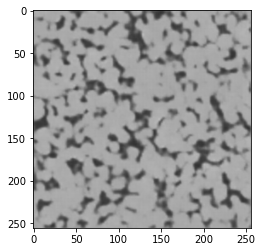

In [163]:
plt.imshow(images[2], 'gray')
print(sample)

### plotting distribution of images

across x and y dimensions

In [155]:
steps = np.arange(-3,3.75,.75)
k = 0
for i in steps:
    for j in steps:
        decode_sample(i, j, 0, f'output/distribution/xy/{k}.png')
        k += 1

In [157]:
image = np.zeros((9*256, 9*256))
k = 0
for i in range(0, image.shape[0], 256):
    for j in range(0, image.shape[1], 256):
        sample = cv2.imread(f'output/distribution/xy/{k}.png')
        sample = cv2.cvtColor(sample , cv2.COLOR_BGR2GRAY)
        image[i:i+256,j:j+256] = sample
        k += 1
        
plt.imsave('xy_distribution.png', image, cmap = 'gray')

### gif testing

In [164]:
points = []
for i in steps:
    for j in steps:
        for k in steps:
             points.append(np.array([i, j, k]))
                
points = np.array(points)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 729/729 [00:45<00:00, 15.97it/s]


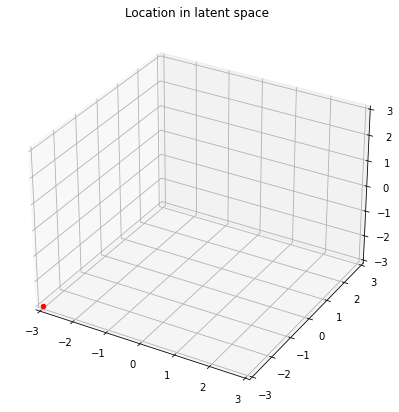

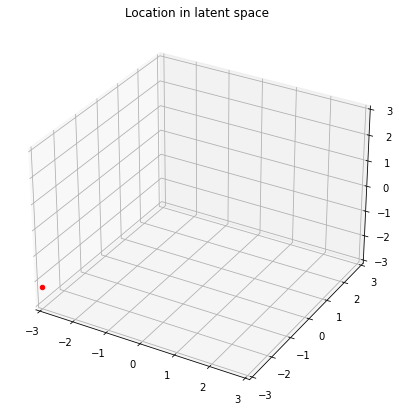

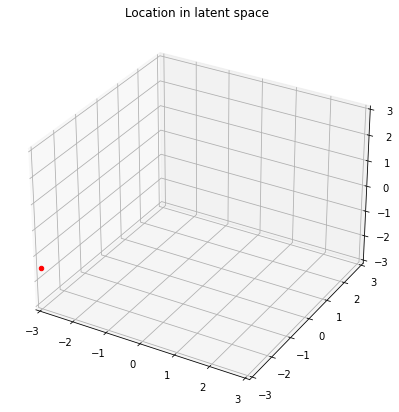

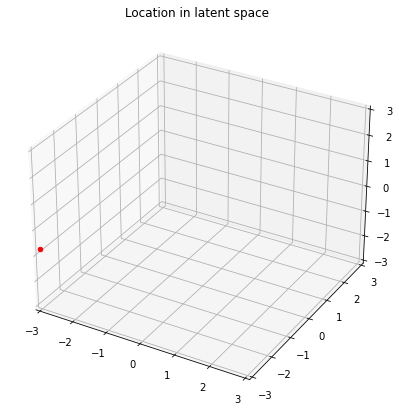

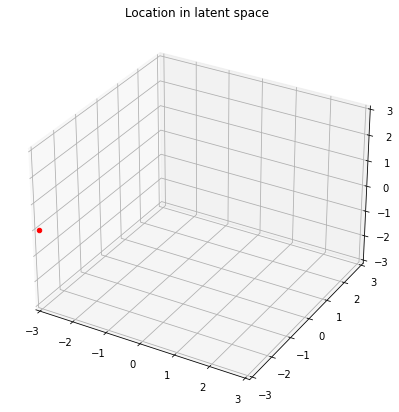

...

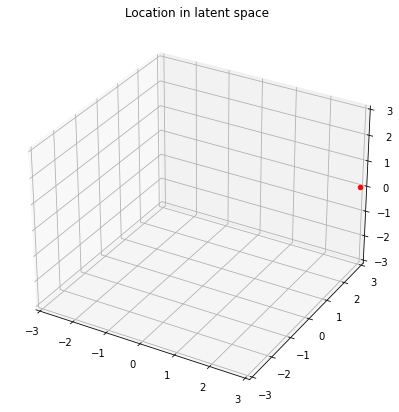

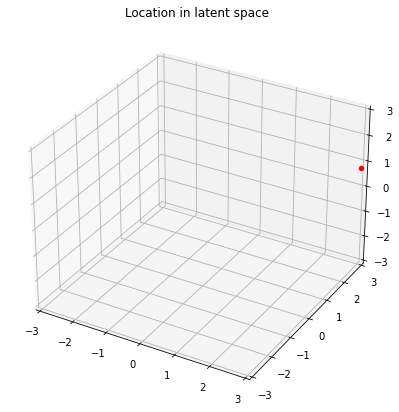

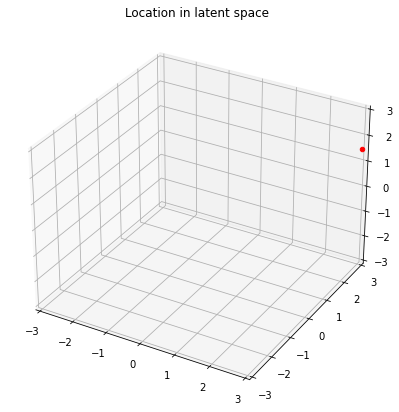

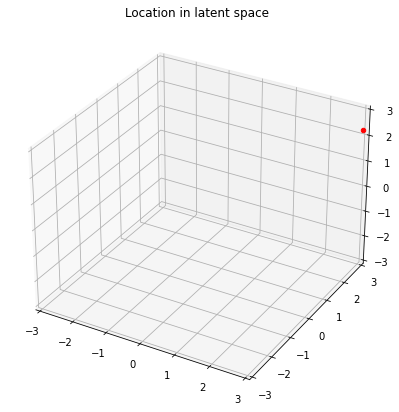

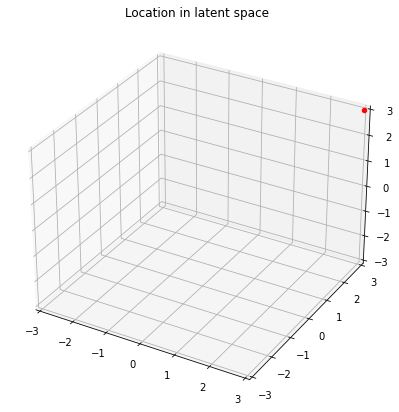

In [211]:
for i, point in tqdm(enumerate(points), total=points.shape[0]):
    
    x, y, z = point
    # Creating figure
    fig = plt.figure(figsize = (10, 7))
    ax = plt.axes(projection ="3d")

    # Creating plot
    ax.scatter3D(x, y, z, color = "red")
    plt.title("Location in latent space")
    
    ax.set_xlim3d(-3, 3)
    ax.set_ylim3d(-3, 3)
    ax.set_zlim3d(-3, 3)

    # save plot for gif
    plt.savefig(f'gif/plots/{i}.png')
    
    # generating image
    decode_sample(x, y, z, f'gif/images/{i}.png')

In [238]:
len_gif = len(os.listdir('gif/plots'))
frames = []
for i in tqdm(range(len_gif)):
    plot = cv2.imread(f'gif/plots/{i}.png')
    image = cv2.imread(f'gif/images/{i}.png')
    plot = cv2.resize(plot, (256,256))
    frame = np.concatenate((plot,image),axis=1)
    frames.append(frame)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 729/729 [00:02<00:00, 291.25it/s]


In [241]:
# save it as a gif
from moviepy.editor import ImageSequenceClip

clip = ImageSequenceClip(list(frames), fps=20)
clip.write_gif('gif/test.gif', fps=30)

MoviePy - Building file gif/test.gif with imageio.


### testing

walking the x axis

In [64]:
for i,x in enumerate(np.arange(-4,4,.05)):
    frame = decode_sample(x,0,0,f'output/test/{i}.png')

folder_path = 'output/test'
frames = []
for i,x in enumerate(np.arange(-4,4,.05)):
    frame = cv2.imread(f'output/test/{i}.png')
    
    text = f'x: {np.round(x,2)}, y: 0, z: 0'
    pos = (0,250)
    font = cv2.FONT_HERSHEY_SIMPLEX
    
    frame = cv2.putText(frame, text, org=pos, color=(255,0,0), fontFace = font, fontScale = .5)
    frames.append(frame)
    
# save it as a gif
from moviepy.editor import ImageSequenceClip

clip = ImageSequenceClip(list(frames), fps=20)
clip.write_gif('test_x.gif', fps=60)

MoviePy - Building file test_x.gif with imageio.


walking the y axis

In [168]:
for i,y in enumerate(np.arange(-4,4,.05)):
    frame = decode_sample(0,y,0,f'output/test/{i}.png')

folder_path = 'output/test'
frames = []
for i,y in enumerate(np.arange(-4,4,.05)):
    frame = cv2.imread(f'output/test/{i}.png')
    
    text = f'x: 0, y: {np.round(y,2)}, z: 0'
    pos = (0,250)
    font = cv2.FONT_HERSHEY_SIMPLEX
    
    frame = cv2.putText(frame, text, org=pos, color=(255,0,0), fontFace = font, fontScale = .5)
    frames.append(frame)
    
# save it as a gif
from moviepy.editor import ImageSequenceClip

clip = ImageSequenceClip(list(frames), fps=20)
clip.write_gif('test_y.gif', fps=60)

MoviePy - Building file test_y.gif with imageio.


In [87]:
def test(variable_axis, fixed_axis_1, fixed_axis_2):  
    folder_path = 'output/test'
    frames = []
    
    if variable_axis == 'x':
        for i,x in enumerate(np.arange(-4,4,.05)):
            frame = decode_sample(x,fixed_axis_1,fixed_axis_2,f'output/test/{i}.png')
        for i,x in enumerate(np.arange(-4,4,.05)):
            frame = cv2.imread(f'output/test/{i}.png')

            text = f'x: {np.round(x,2)}, y: {fixed_axis_1}, z: {fixed_axis_2}'
            pos = (0,250)
            font = cv2.FONT_HERSHEY_SIMPLEX

            frame = cv2.putText(frame, text, org=pos, color=(255,0,0), fontFace = font, fontScale = .5)
            frames.append(frame)
            
    elif variable_axis == 'y':
        for i,y in enumerate(np.arange(-4,4,.05)):
            frame = decode_sample(fixed_axis_1,y,fixed_axis_2,f'output/test/{i}.png')
        for i,y in enumerate(np.arange(-4,4,.05)):
            frame = cv2.imread(f'output/test/{i}.png')

            text = f'x: {fixed_axis_1}, y: {np.round(y,2)}, z: {fixed_axis_2}'
            pos = (0,250)
            font = cv2.FONT_HERSHEY_SIMPLEX

            frame = cv2.putText(frame, text, org=pos, color=(255,0,0), fontFace = font, fontScale = .5)
            frames.append(frame)
            
    elif variable_axis == 'z':
        for i,z in enumerate(np.arange(-4,4,.05)):
            frame = decode_sample(fixed_axis_1,fixed_axis_2,z,f'output/test/{i}.png')
        for i,z in enumerate(np.arange(-4,4,.05)):
            frame = cv2.imread(f'output/test/{i}.png')

            text = f'x: {fixed_axis_1}, y: {fixed_axis_2}, z: {np.round(z,2)}'
            pos = (0,250)
            font = cv2.FONT_HERSHEY_SIMPLEX

            frame = cv2.putText(frame, text, org=pos, color=(255,0,0), fontFace = font, fontScale = .6)
            frames.append(frame)
            
    else:
        print("choose valid axis ('x', 'y' or 'z')")
        return None
        
    # save it as a gif
    from moviepy.editor import ImageSequenceClip

    clip = ImageSequenceClip(list(frames), fps=20)
    filename = variable_axis + f'_{fixed_axis_1}_{fixed_axis_2}.gif'
    clip.write_gif('gif/variable_gifs/' + filename, fps=60)
    print(f'Gif created at gif/variable_gifs/{filename}')

In [89]:
test('y',-3,3)

MoviePy - Building file gif/variable_gifs/y_-3_3.gif with imageio.


Gif created at gif/variable_gifs/y_-3_3.gif
